# Template script to investigate celltype clusters
#### Remarks and how to use this script:
- At those places where user input is needed the <span style="color:green">explanation</span> is highlighted in green and typically user defined `VARIABLE`s consist of capital letters. 
- with correct user input the script should be able to run through
- more computationally/time expensive optional parts have an orange <span style="color:orange">**title**</span>
- adjust the `S` & `S_NEIGHBORS` parameters for umap plots to set proper dot sizes

#### Goals:
- investigate preliminary celltype clusters (marker/DE genes, trajectories)
- define the celltype's substates
- eventually reannotate subclusters to other celltypes

#### Outline:
- [Load data](#Load-data)
- [Set up general parameters](#Set-up-general-parameters)
    - <span style="color:green">Define general parameters</span>
    - subset the dataset. We consider two versions:
        - `adata`: subset <span style="color:green">to celltype of interest `CT_OI`</span>
        - `adata_n`: subset <span style="color:green">to celltype of interest `CT_OI` and the closest neighbouring celltypes `CT_NEIGHBORS`</span>
    - <span style="color:green">Define good known markers for the potential celltypes/states</span>        
- [compute leiden clustering (and umap)](#Leiden-clustering-and-Umaps)
    - save the umap of the full dataset in `adata.uns['X_umap_original']` for referencing to the original umap
    - recompute pca, knn, umap on subsets
    - compute leiden clusterings for `resultions=[0.25,0.5,1]`
- [plot umaps to get an overview](#Plot-Umaps) + decide which leiden resolutions make sense
    - umap plots with lots of infos
        - mt_fraction, cell_cycle_score, n_counts, n_genes
        - good markers for the given celltype + for celltype states + for close celltypes!
    - <span style="color:green">Based on the umaps optionally filter out leiden resolutions that are not interesting</span> (this is only to eventually shorten the DE results)
- [compute and plot DE genes](#DE-genes)
    - [Celltype level](#DE-genes-Celltype-level):
        1. DE genes: celltype vs all other celltypes of the dataset
        2. DE genes: celltype vs neighboring celltypes
    - [leiden clustering level](#DE-genes-Leiden-level) (for each resolution):
        3. DE genes: each leiden cluster vs the other leiden clusters
    - For each DE test we print how many and which genes of the marker list occur in the top 30 DE genes
- [trajectories](#Trajectory-analysis)
    - [compute pseudotime](#Pseudotime). <span style="color:green">To do so choose one option of root points</span>
    - <span style="color:orange">compute [velocities and cell rank](#Velocity/Cellrank) start/final states</span> (if needed <span style="color:green">set a subset number for faster computation</span>)
- [final decisions and cluster infos](#Final-mappings)
    - <span style="color:green">[create mappings](#Cluster-mappings)</span>: possible mappings are
        - <span style="color:green">leiden clusters to celltype states ("level 2 annotation")</span>
        - <span style="color:green">optionally reannoate leiden cluster to another celltype ("level 1 annotation")</span>
    - pool leiden clusters to celltype states according mapping to [final clusters](#Final-clusters) +
        - compute DE genes GO terms for each defined final cluster
        - frequency plots of final celltype/state propotions

# Imports and plot settings

In [1]:
import os 
import numpy as np
import itertools
import pandas as pd
import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt

import scanpy as sc
import anndata as ann
import scvelo as scv
import cellrank as cr

import scipy as sci
from scipy import sparse
from scipy.sparse import csr_matrix, issparse
from matplotlib import rcParams
from matplotlib import colors

sc.settings.verbosity = 3
sc.logging.print_header()#print_versions()
print(f"scvelo=={scv.__version__}")
print(f"cellrank=={cr.__version__}")

rcParams['figure.figsize']= (10,10)

scanpy==1.6.1 anndata==0.7.5 umap==0.4.6 numpy==1.19.5 scipy==1.6.0 pandas==1.2.0 scikit-learn==0.24.0 statsmodels==0.12.1 python-igraph==0.8.3 louvain==0.7.0 leidenalg==0.8.3
scvelo==0.2.3
cellrank==1.1.0


# Load data
<sup>[[back to overview]](#Template-script-to-investigate-celltype-clusters)</sup>   
- <span style="color:green">Define directory `DATA_DIR`: folder where `cellxgene_dec20.h5ad` is located</span>
- <span style="color:orange">if you want to also compute velocities you need the file `cellxgene_dec20_loom_merged.h5ad` in `DATA_DIR` as well</span>



In [2]:
DATA_DIR = '/storage/groups/ml01/workspace/louis.kuemmerle/projects/A1/data2/' # "./../"
DATA_VERSION = 'april21'
WITH_SHAM = True # load data set with sham
WITH_VELO_INFO = True # load data set with unspliced spliced information (in case u want to run velocity analyses)


sham_str = '_wSham' if WITH_SHAM else ''
velo_str = '_loom_merged' if WITH_VELO_INFO else ''
data_path = DATA_DIR+f'cellxgene_{DATA_VERSION}{sham_str}{velo_str}.h5ad'
results_file_path = DATA_DIR+f'fine_annotations_{DATA_VERSION}{sham_str}.csv' # csv file corresponding to adata.obs to save the results

In [3]:
adata_original = sc.read(data_path)

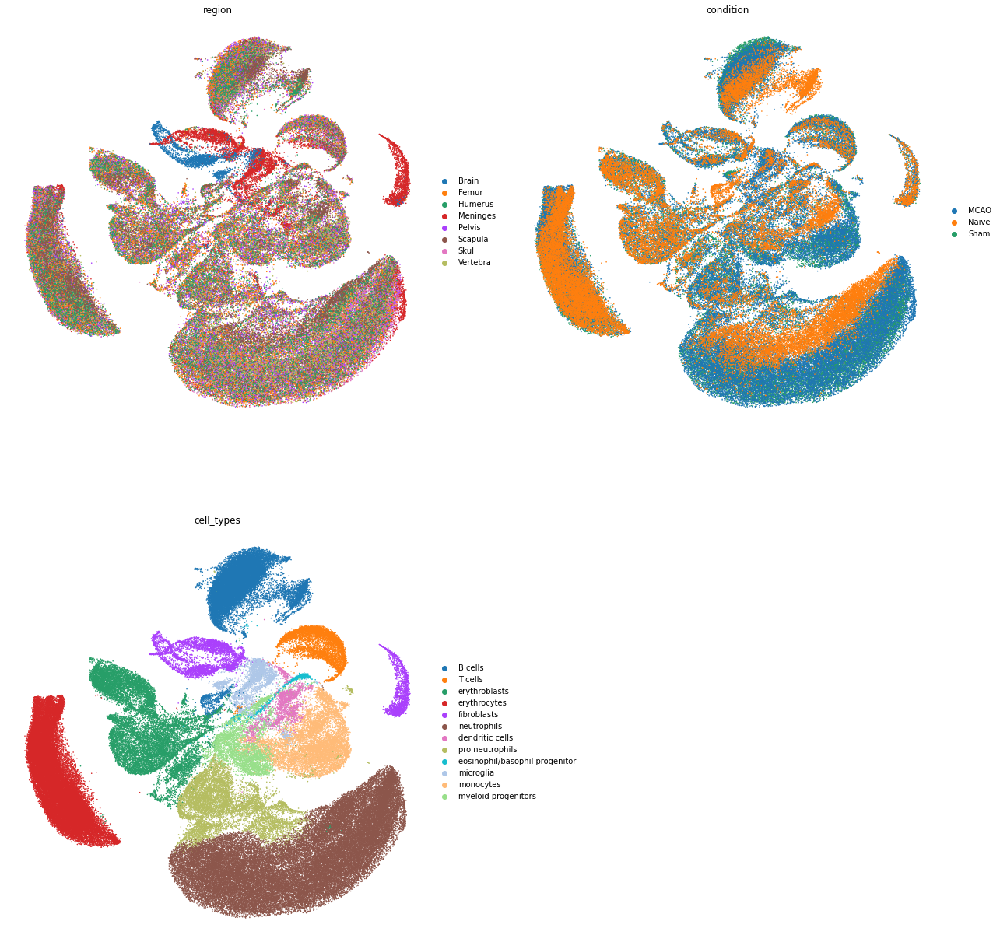

In [4]:
sc.pl.umap(adata_original, color=['region','condition','cell_types'], frameon=False, ncols=2,s=10)

# Set up general parameters
<sup>[[back to overview]](#Template-script-to-investigate-celltype-clusters)</sup>   


### Celltype specific params
<sup>[[back to overview]](#Template-script-to-investigate-celltype-clusters)</sup>   
- `CT_OI`: <span style="color:green">celltype of interest</span>
- `CT_NEIGHBORS`: <span style="color:green">neighboring celltypes</span>

In [5]:
CT_OI = 'neutrophils'
CT_NEIGHBORS = ['pro neutrophils']

## Subset datasets
<sup>[[back to overview]](#Template-script-to-investigate-celltype-clusters)</sup>   

In [6]:
adata = adata_original[adata_original.obs['cell_types'] == CT_OI].copy()
adata_n = adata_original[np.in1d(adata_original.obs['cell_types'],[CT_OI]+CT_NEIGHBORS)].copy()

<span style="color:green">Set umap dotsizes here (`S` for `adata` and `S_NEIGHBORS` for `adata_n`)</span>

########## adata ##########


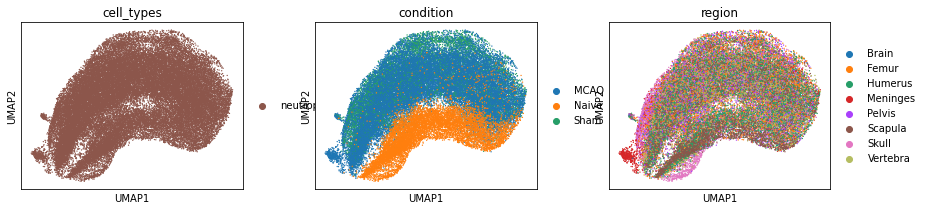

########## adata_n ##########


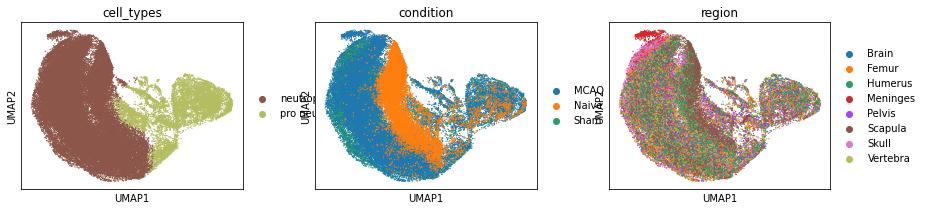

In [52]:
S = 7
S_NEIGHBORS = 7
print(f"########## adata ##########")
sc.pl.umap(adata,color=['cell_types','condition','region'],s=S)
print(f"########## adata_n ##########")
sc.pl.umap(adata_n,color=['cell_types','condition','region'],s=S_NEIGHBORS)

### Good known markers
<sup>[[back to overview]](#Template-script-to-investigate-celltype-clusters)</sup>   
Here we want to define a list of known markers for celltypes and states. 
- <span style="color:green">This should be done once before investigating the first celltype</span>
- in this list we want to have markers for all celltypes that we already have 
- and markers for celltypes that we potentially find in the dataset
- additional markers that tell us more about states (e.g. precursor, aged, cycling, whatever) are also interesting
- <span style="color:green">just add a dictionary key and a list for each new entry in `MARKER_DICT`</span>


In [53]:
# GENERAL REMARK: I selected quite some genes from the umaps we created last time that look very specific in our dataset! 
#                 That's a pretty biased selection, maybe we need to recheck some markers...
#                 Overall, i think i've put in quite some good markers (also from other resources) but all should be double checked
#                 We should definitely add additional states and markers (e.g. these cool macrophage states etc.)
#                 Ideally we have the resources for the genes written down here. If we use them later for discussions in the paper
#                 it's nice to quickly have the citation. 

# When adding genes: 
# - try to keep an order, best gene first.
# - also just add as many genes as you want as long as they are good, I've included a parameter that uses only up to three genes for the plots later

MARKER_DICT = {
    # Multipotent progenitors
    'hematopoietic stem cell'    : ['Ly6a', 'Cd38'],
    # https://stemcells.nih.gov/info/2001report/chapter5.htm 
    #other markers present here were not identified in our data
    
    # Myeloid
    'myeloid progenitors'             : ['Cd34', 'Cd38'],
    
    'GMP'                             : ['Elane','Mpo','Ctsg','Prss57','Cst7', 'Prom1'],
    'neutrophils_G0-G1'               : ['Cd34', 'Sox4', 'Rpl12', 'Elane', 'Prtn3', 'Mpo'],
    'neutrophils_G2-G3'               : ['Fcnb', 'Ltf', 'Ngp', 'Camp'],
    'neutrophils_G4'                  : ['Retnlg', 'Mmp8','Ccl6','Cxcl2'],
    'Interferon-stimulated gene related neutrophils' : ['Ifitm3', 'Isg15'],
    'monocytes'                       : ['Ccr2', 'Itgam', 'Sell', 'Cd14'], 
    'classical monocytes'             : ['Cd14', 'Ccr2', 'Ccr5', 'Sell'], 
    #80 to 90 percent of circulating blood monocytes, higher levels of phagocytic and antimicrobial activity, sensing and immune response, and cell migration
    'Non-classical monocytes'         : ['Cd16', 'Fcgr3', 'Cx3cr1', 'Spn'],
# the non-classical subset is associated with reduced phagocytosis and lower production of ROS and pro-inflammatory cytokines. Instead of performing more traditional monocyte duties, they are known to patrol the walls of blood vessels, promote wound healing, and respond to vira
#infections
    'intermediate monocytes'          : ['S100a10', 'Lyz', 'S100a8', 'Cd14', 'Cd74'],
    #this subpopulation also displays inflammatory properties and does not patrol blood vessels. However, like non-classical monocytes, they feature lower peroxidase activity and also secrete TNF and IL-1B
#https://www.biocompare.com/Editorial-Articles/567890-A-Guide-to-Monocyte-Markers/#:~:text=In%20humans%2C%20classical%20monocytes%20are,as%20CD14%2B%2B%20CD16%E2%88%92).&text=The%20equivalent%20subset%20in%20mice,CCR2%2B%20CD62L%2B%20CD43Low.
    
    "eosinophil/basophil progenitor"  : ['Ms4a2','Hdc','Gata2','Ifitm1'], 
    'basophils'                       : ['Hdc', 'Cpa'],
    'eosinophils'                     : ['Gapt','Clc'],
    
    'Erythroid/Megakaryocyte progenitors' : ['Cd38', 'Slc3a2'],
    'erythroid progenitors'           : ['Car1','Vamp5', 'Top2a', 'Tmpo'],
    'Erytroid'                        : ['Itga4', 'Foxo3'],
    'erythroblasts'                   : ['Car2','Prdx2','Glrx5', 'Foxo4', 'Tcea1'], # maybe these we could call Reticulocyte?
    'erythrocytes'                    : ['Hbb-bs','Hba-a2','Hba-a1','Hbb-bt'], # or maybe these are reticulocytes and we don't have erythrocytes at all?
    'Megakaryocyte progenitors'       : ['Cd34', 'Cd49b'],

    # Lymphocytes
    'Lymphoid-primed MPs'             : ['Ctla2a','Cd34'],
    'dendritic cells'                 : ['Itgax','Siglech','Bst2','Cox6a2'],
    'pDC'                             : ['Tcf4', 'Ptprc', 'Bst2'],
    'cDC1'                            : ['Batf3','Irf8','Nfil3','Id2', 'Xcr1'],
    'cDC2'                            : ['Irf4','RelB','Rbpj', 'Ccr7'],
    #'pre-B cell'                      : ['Vpreb3','Dnajc7','Pafah1b3','Ebf1'],
    'B cells'                         : ['Cd79a','Cd79b','Ms4a1', 'Ptprc', 'Cd19', 'Ighm'],
    'B cells immatureANDmature'       : ['Ms4a1', 'Ms4a4c', 'H2-Aa', 'Sell', 'Apoe', 'Ltb'],
    #'pro-B-cell'                      : ['Cr2', 'Cd22', 'Vpreb1', 'Vpreb3'],
    #'pre-B-cells'                     : ['Ebf1', 'Bcl7a', 'Cecr2'],
    'cycl. pro B cell'                : ['Kit','Bok','Ifitm2','Ifitm3'],
    'pre-pro-B cell'                  : ['Tyrobp','Clec12a','Cd300a','Cd7','Chdh','Mycl'],
    'preBCR dependent expension'      : ['Myc','Nrgn','Ybx3','Ybx1','Slc7a5','Slc3a2'],
    'Lambda preB/Kappa preB/proB VDJ' : ['Rag1', 'Rag2', 'Iglc1', 'Iglc2', 'Iglc3', 'Igkc'],
    #'immature B-cells'                : ['Ptprc', 'Cd19', 'Ms4a1'],
    'Plasma (B-cells)'                : ['Bcl2', 'Bcl6'],
    'T cells'                         : ['Cd3g','Cd3d','Cd27', 'Cd7', 'Cd3', 'Cd2'],
    'Cd4 T cells'                     : ['Cd28', 'Cd4'],
    'Cd8 T cells'                     : ['Cd8a'],
    'gamma-delta T cells'             : ['Cd7', 'Cd2', 'Klrd1', 'Klrk1'],  
    'NK cells'                        : ['Ccl5','Nkg7', 'Klrk1', 'Cd96'],
    'macrophages'                     : ['Ccr5', 'Cd14', 'Cd163', 'Cd86', 'Cd68'],
    'perivascular macrophages'        : ['Cd163', 'Mrc1', 'Cd163', 'Cd68'],
    
    # Overlapping functions
    'Cycling'                         : ['Mki67', 'Pcna', 'Mcm2'],
    
    # Microglia
    'microglia'                       : ['Hexb', 'P2ry12'],    
    
    # Others
    'fibroblasts'                     : ['Col12a1', 'Dcn', 'Col1a1', 'Foxc1', 'Fxyd5', 'Cdkn1c', 'Ptgds'], #fxyd5 is specific to dural meninges, cdkn1c and ptgds, not specific but clustered for arachnoid
    'neurons'                         : ['Rbfox3', 'Tubb3', 'Map2', 'Grin1'],
    'astrocytes'                      : ['GFAP', 'Aldh1l1', 'Aldoc', 'S100b', 'Ndrg2'],
    'oligodendrocytes'                : ['Pdgfra', 'Olig1', 'Olig2']
}
# Can we check the gene 'Mif'? It looks to me that it's expressed in all very early progenitors but not in the earliest (?) myeloid progenitors


Based on the celltypes in `MARKER_DICT`:
- <span style="color:green">choose the celltypes/states that we want to investigate for the given celltype in `CTS_OI`</span>

In [54]:
CTS_OI = ['GMP','neutrophils_G0-G1','neutrophils_G2-G3','neutrophils_G4','Interferon-stimulated gene related neutrophils']
if CTS_OI == 'all':
    CTS_OI = [ct for ct in MARKER_DICT]

##### Filter out genes from `MARKER_DICT` that are not in adata.var

In [55]:
max_gene_length = max([len(g) for _,genes in MARKER_DICT.items() for g in genes])
max_ct_length = max([len(ct) for ct in MARKER_DICT])

for ct, genes in MARKER_DICT.items():
    for g in genes.copy():
        if not g in adata_original.var.index:
            print(f"Gene {g:<{max_gene_length}} of cell type {ct:<{max_ct_length}} is not in adata.var. Gene is filtered out")
            MARKER_DICT[ct].remove(g)
full_marker_dict = MARKER_DICT.copy()

Gene Cd16    of cell type Non-classical monocytes                        is not in adata.var. Gene is filtered out
Gene Lyz     of cell type intermediate monocytes                         is not in adata.var. Gene is filtered out
Gene Cpa     of cell type basophils                                      is not in adata.var. Gene is filtered out
Gene Clc     of cell type eosinophils                                    is not in adata.var. Gene is filtered out
Gene Cd49b   of cell type Megakaryocyte progenitors                      is not in adata.var. Gene is filtered out
Gene RelB    of cell type cDC2                                           is not in adata.var. Gene is filtered out
Gene Cd3     of cell type T cells                                        is not in adata.var. Gene is filtered out
Gene GFAP    of cell type astrocytes                                     is not in adata.var. Gene is filtered out


##### Use only the celltypes in `CTS_OI` and `n_top_markers=3` genes per celltype for subsequent plots

In [56]:
n_top_markers = 3
MARKER_DICT = {ct:genes[:n_top_markers] for ct,genes in MARKER_DICT.items() if ct in CTS_OI}

# Leiden clustering and Umaps
<sup>[[back to overview]](#Template-script-to-investigate-celltype-clusters)</sup>   

### Save original umap

In [57]:
adata.obsm['X_umap_original'] = adata.obsm['X_umap'].copy()
adata_n.obsm['X_umap_original'] = adata_n.obsm['X_umap'].copy()
del adata.uns['umap']
del adata_n.uns['umap']
del adata.obsm['X_umap']
del adata_n.obsm['X_umap']

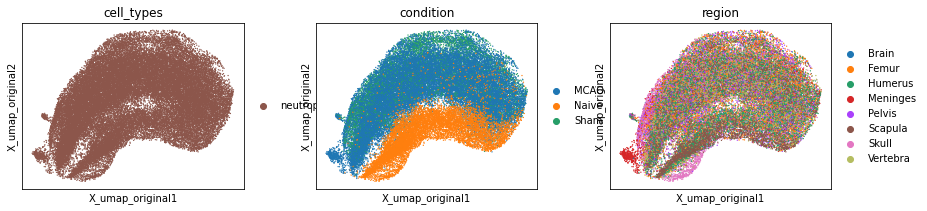

In [58]:
sc.pl.embedding(adata,'X_umap_original',color=['cell_types','condition','region'],s=S)

### Recompute pca, knn, umap on subsets
<sup>[[back to overview]](#Template-script-to-investigate-celltype-clusters)</sup>   

In [16]:
def clean_for_umap(adata,verbose=True):
    if 'neighbors' in adata.uns: 
        del adata.uns['neighbors']
        if verbose: print("Deleted adata.uns['neighbors']")
    if 'pca' in adata.uns: 
        del adata.uns['pca']
        if verbose: print("Deleted adata.uns['pca']")
    if 'X_pca' in adata.obsm: 
        del adata.obsm['X_pca']
        if verbose: print("Deleted adata.obsm['X_pca']")
    if 'X_umap' in adata.obsm: 
        del adata.obsm['X_umap']
        if verbose: print("Deleted adata.obsm['X_umap']")
    if 'PCs' in adata.varm: 
        del adata.varm['PCs']
        if verbose: print("Deleted adata.varm['PCs']")
    if 'connectivities' in adata.obsp: 
        del adata.obsp['connectivities']
        if verbose: print("Deleted adata.obsp['connectivities']")
    if 'distances' in adata.obsp: 
        del adata.obsp['distances']
        if verbose: print("Deleted adata.obsp['distances']")

In [60]:
for a in [adata,adata_n]:
    clean_for_umap(a)
    sc.tl.pca(a)
    sc.pp.neighbors(a)
    sc.tl.umap(a)

Deleted adata.uns['neighbors']
Deleted adata.uns['pca']
Deleted adata.obsm['X_pca']
Deleted adata.varm['PCs']
Deleted adata.obsp['connectivities']
Deleted adata.obsp['distances']
Deleted adata.uns['neighbors']
Deleted adata.uns['pca']
Deleted adata.obsm['X_pca']
Deleted adata.varm['PCs']
Deleted adata.obsp['connectivities']
Deleted adata.obsp['distances']


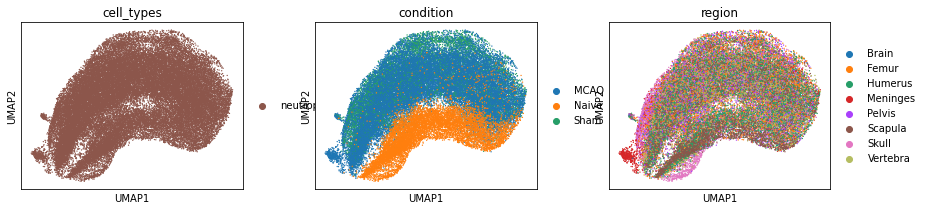

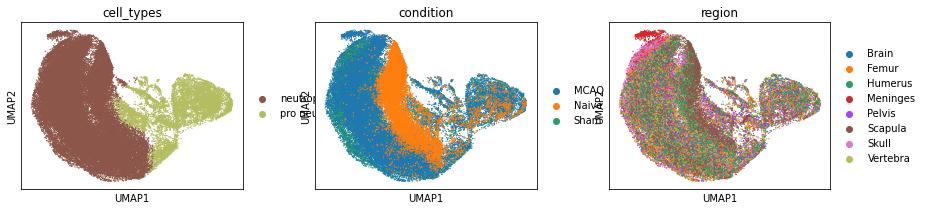

In [61]:
sc.pl.umap(adata,color=['cell_types','condition','region'],s=S)
sc.pl.umap(adata_n,color=['cell_types','condition','region'],s=S_NEIGHBORS)

### Compute leiden clusterings for `resultions=[0.25,0.5,1]`
<sup>[[back to overview]](#Template-script-to-investigate-celltype-clusters)</sup>   
(<span style="color:green">Adjust `resolutions` if finer/coarser clusterings are needed</span>)

In [67]:
resolutions = [0.25,1,3.5]
for res in resolutions:
    sc.tl.leiden(adata,resolution=res,key_added=f"leiden_{res}")

In [68]:
for res in resolutions:
    adata_n.obs[f"leiden_{res}"] = adata_n.obs['cell_types'].values.copy()
    adata_n.obs[f"leiden_{res}"] = adata_n.obs[f"leiden_{res}"].astype(str)
    adata_n.obs.loc[adata.obs.index,f"leiden_{res}"] = adata.obs.loc[adata.obs.index,f'leiden_{res}'].values.copy()

# Plot Umaps
<sup>[[back to overview]](#Template-script-to-investigate-celltype-clusters)</sup>   

##### Clustering overview

... storing 'leiden_3.5_easy' as categorical


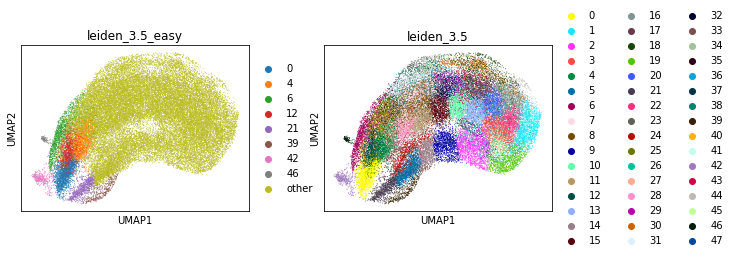

In [74]:
adata.obs['leiden_3.5_easy']
adata.obs['leiden_3.5_easy'] = 'other'
tmp_clusters = ['39','42','6','21','46','0','12','4']
adata.obs.loc[adata.obs['leiden_3.5'].isin(tmp_clusters),'leiden_3.5_easy'] = adata.obs.loc[adata.obs['leiden_3.5'].isin(tmp_clusters),'leiden_3.5']
sc.pl.umap(adata,color=['leiden_3.5_easy','leiden_3.5'])

adata.obs['leiden_3.5'] = adata.obs['leiden_3.5_easy']

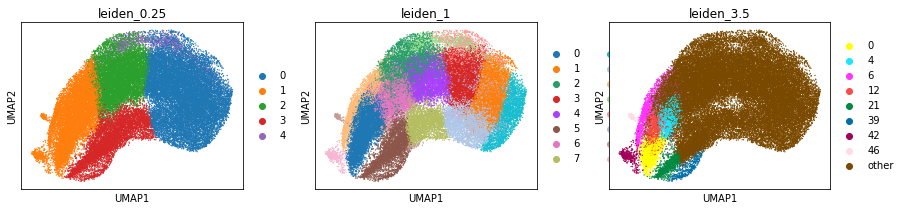

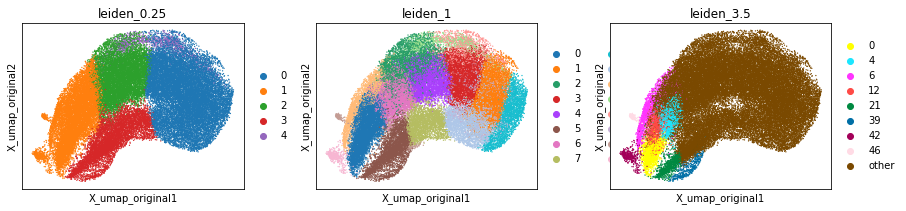

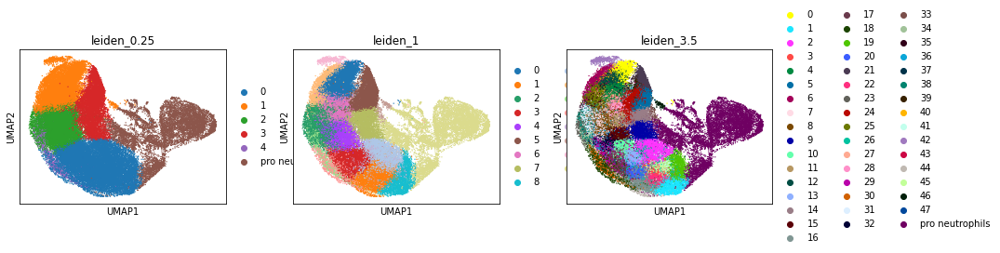

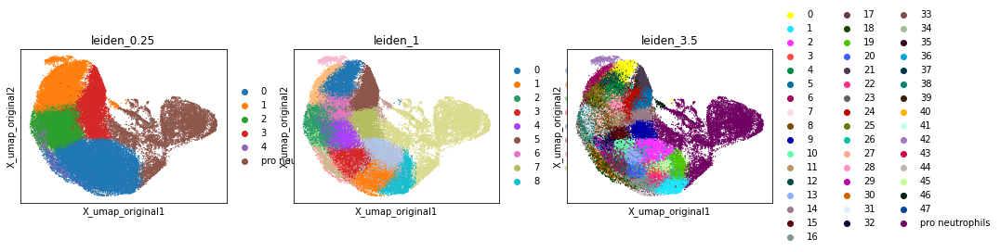

In [77]:
sc.pl.umap(adata,color=[f"leiden_{res}" for res in resolutions],s=S)
sc.pl.embedding(adata,'X_umap_original',color=[f"leiden_{res}" for res in resolutions],s=S)
sc.pl.umap(adata_n,color=[f"leiden_{res}" for res in resolutions],s=S_NEIGHBORS)
sc.pl.embedding(adata_n,'X_umap_original',color=[f"leiden_{res}" for res in resolutions],s=S_NEIGHBORS)

##### Batch, condition and region effects might give insights into wether clusters refer to vanilla celltype states or some special effect related states

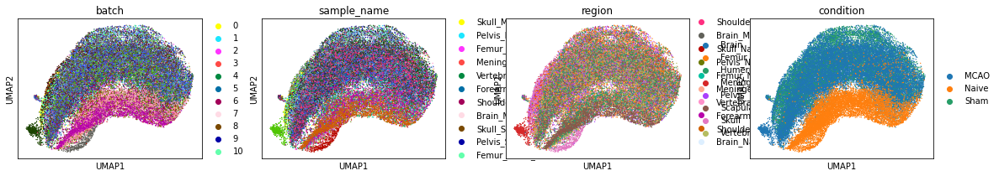

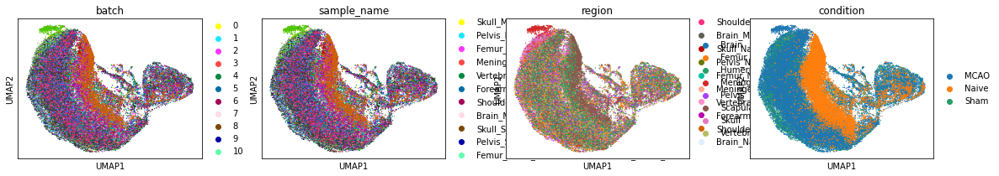

In [78]:
sc.pl.umap(adata,color=['batch','sample_name','region','condition'],s=S)
sc.pl.umap(adata_n,color=['batch','sample_name','region','condition'],s=S_NEIGHBORS)

##### Cellcycle score (and number of genes) might give insights on cell cycle and trajectory

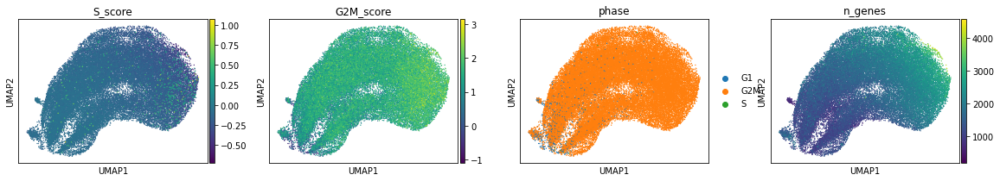

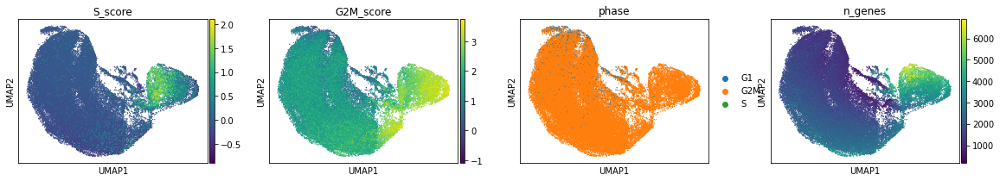

In [79]:
sc.pl.umap(adata,color=['S_score','G2M_score','phase','n_genes'],s=S)
sc.pl.umap(adata_n,color=['S_score','G2M_score','phase','n_genes'],s=S_NEIGHBORS)

##### For bad cells/contaminations check n_counts and mt_fraction

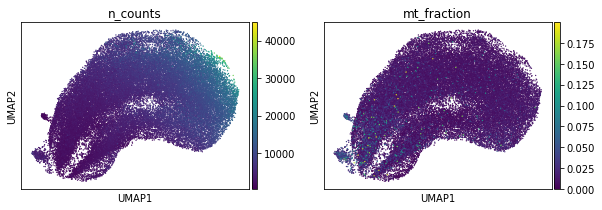

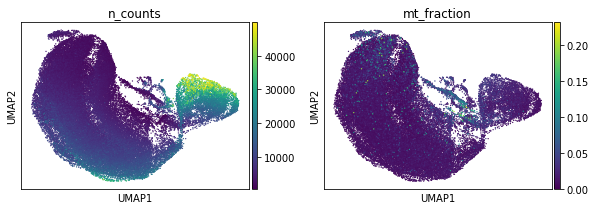

In [80]:
sc.pl.umap(adata,color=['n_counts','mt_fraction'],s=S,ncols=4)
sc.pl.umap(adata_n,color=['n_counts','mt_fraction'],s=S_NEIGHBORS,ncols=4)#

##### Markers from our list

########## Celltype: GMP ##########


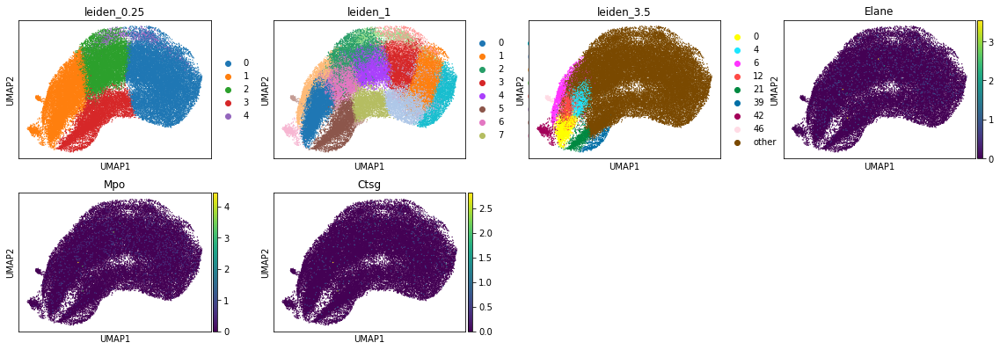

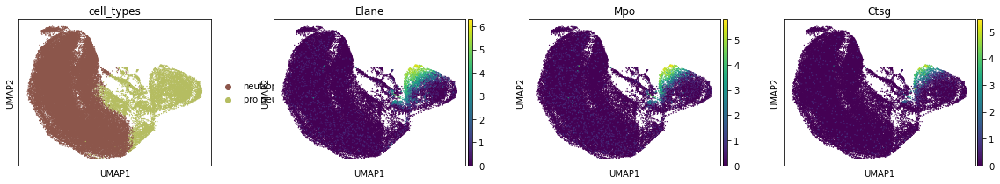

########## Celltype: neutrophils_G0-G1 ##########


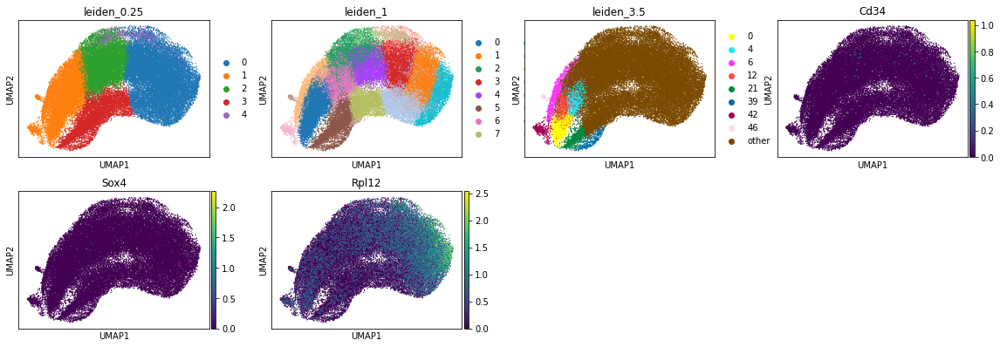

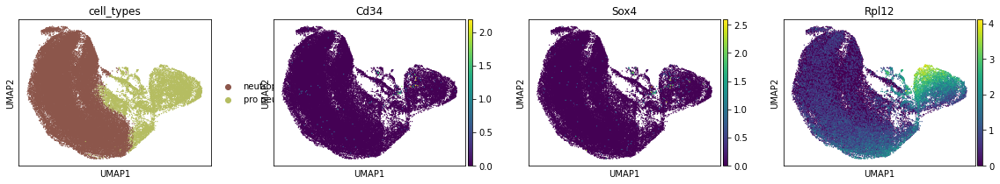

########## Celltype: neutrophils_G2-G3 ##########


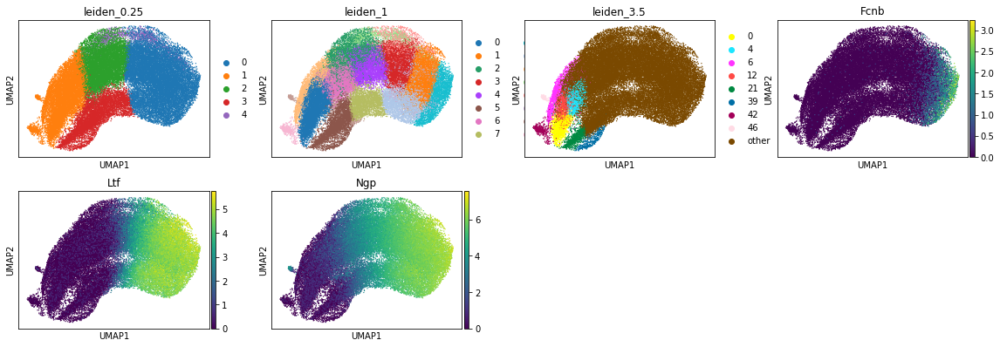

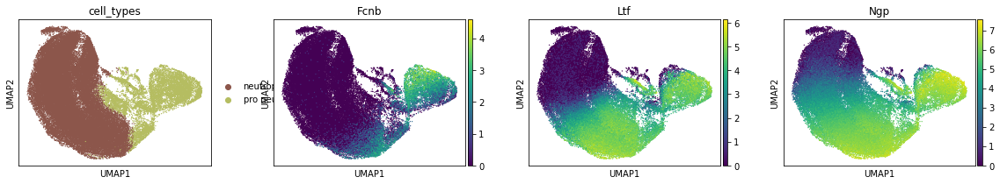

########## Celltype: neutrophils_G4 ##########


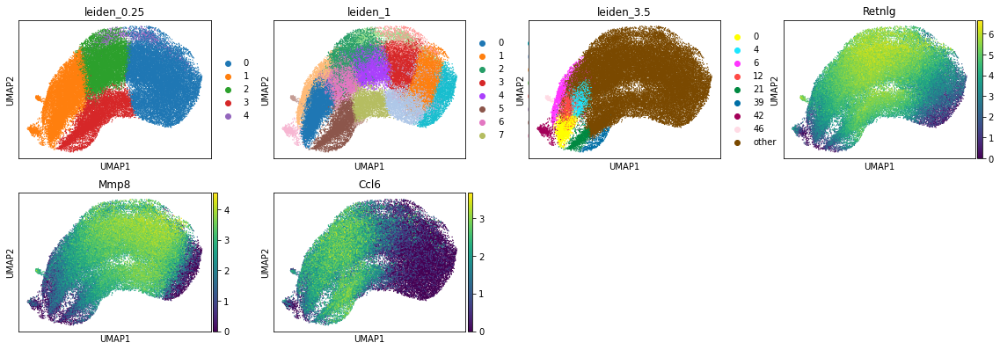

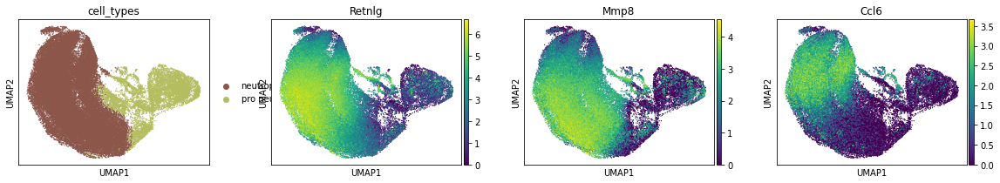

########## Celltype: Interferon-stimulated gene related neutrophils ##########


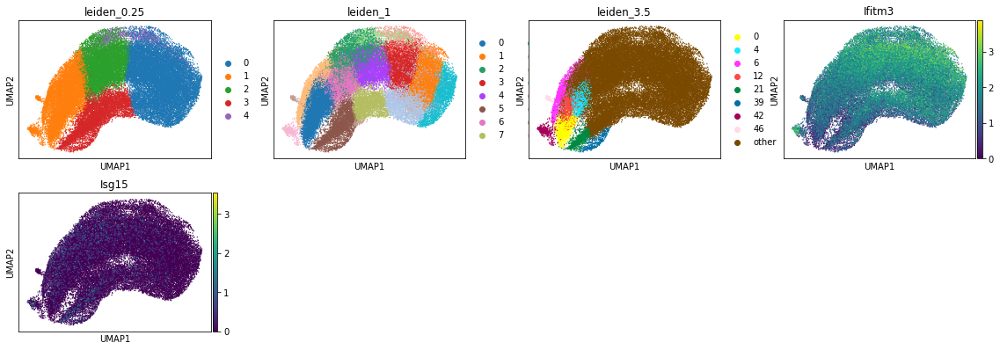

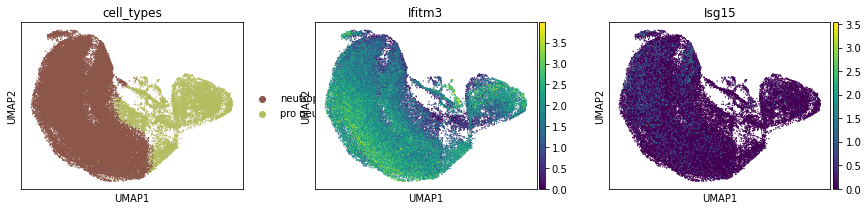

In [81]:
for ct,markers in MARKER_DICT.items():
    if markers:
        print(f"########## Celltype: {ct} ##########")
        sc.pl.umap(adata,color=[f"leiden_{res}" for res in resolutions] + markers,s=S)
        sc.pl.umap(adata_n,color=['cell_types'] + markers,s=S_NEIGHBORS)
    else:
        print(f"#### Celltype {ct} has no markers in MARKER_DICT ###")

### Optionally filter out leiden resolutions
<sup>[[back to overview]](#Template-script-to-investigate-celltype-clusters)</sup>   
<span style="color:green">Set e.g. `FILTER_OUT = [0.25,0.5]` to filter out the resolutions `0.25` and `0.5` for the upcoming analyses. `FILTER_OUT = []` to keep all.</span>

In [82]:
FILTER_OUT = []
resolutions = [res for res in resolutions if not res in FILTER_OUT]

# DE genes
<sup>[[back to overview]](#Template-script-to-investigate-celltype-clusters)</sup>   

compute and plot DE genes
Celltype level:
DE genes: celltype vs all other celltypes of the dataset
DE genes: celltype vs neighboring celltypes
leiden clustering level (for each resolution):
DE genes: each leiden cluster vs the whole dataset
DE genes: each leiden cluster vs the other leiden clusters
For each DE test we print how many and which genes of the marker list occur in the top 30 DE genes

In [83]:
def markers_in_list(genes,marker_dict=full_marker_dict):
    """Print markers in marker_dict that occur in genes
    """
    tmp = {ct:[g for g in gs if g in genes] for ct,gs in marker_dict.items()}
    tmp = {k:tmp[k] for k in sorted(tmp, key=lambda k: len(tmp[k]), reverse=True)}
    
    tmp_list = [len(ct) for ct,markers in tmp.items() if markers]
    max_ct_length = max(tmp_list) if (len(tmp_list) > 0) else 1
    
    for ct,markers in tmp.items():
        if markers:
            print(f"\t{ct:<{max_ct_length}} ({len(markers)} genes): {markers}")
            
def plot_marker_occurence(adata,marker_dict=full_marker_dict,top_DE=30,top_marker=10):
    """Heatmap that shows which marker is in the top DE genes of each ranked cluster
    """
    
    tmp = adata.uns['rank_genes_groups']['names'].copy()
    df1 = pd.DataFrame(data = tmp[:top_DE])
    df2 = pd.DataFrame(columns=['gene','cell_type'], data=[[g,ct] for ct,genes in marker_dict.items() for g in genes[:max([top_marker,len(genes)])]])
    df2 = df2.reindex(columns=df2.columns.tolist()+df1.columns.tolist())
    df2.set_index('gene',inplace=True)
    
    for g in df2.index.values:
        df2.loc[g,df1.columns] = [g in df1[col].values for col in df1.columns]
        
    df2['counts'] = df2[df1.columns].sum(axis=1)
    
    ct_count = df2.groupby(['cell_type']).sum()
    df2['ct_count'] = ct_count.loc[df2['cell_type'].values]['counts'].values
    df2['ct_order'] = (ct_count.loc[df2['cell_type'].values]['counts'].values / df2['cell_type'].value_counts().loc[df2['cell_type'].values]).values
    
    df2 = df2.sort_values(['ct_order','counts'],ascending=False)
    df2 = df2.loc[df2['counts'] > 0]
    
    df2.index = df2.index.values + ' (' + df2['cell_type'].values + ')'
    
    plt.figure(figsize=(0.5*len(df2),0.5*len(df2.columns)))
    ax = sns.heatmap(df2[df1.columns].astype(int),cmap='Greens', linewidths=.5)
    ax.xaxis.set_ticks_position('top')
    plt.xticks(rotation=90)
    plt.title(f"Occurence of the best {top_marker} markers from MARKER_DICT in each cluster's top {top_DE} DE genes")
    plt.show()            

## DE genes Celltype level
<sup>[[back to overview]](#Template-script-to-investigate-celltype-clusters)</sup>   

### Test celltype (`CT_OI`) vs full dataset background
<sup>[[back to overview]](#Template-script-to-investigate-celltype-clusters)</sup>   

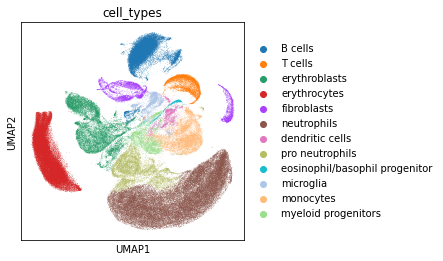

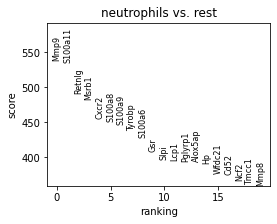

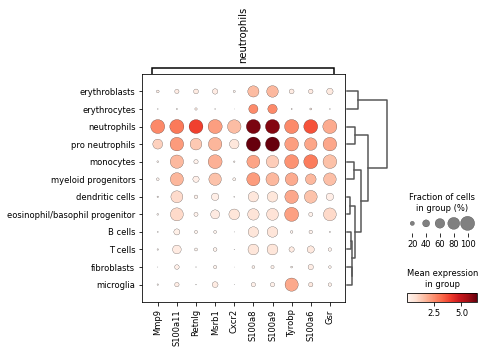

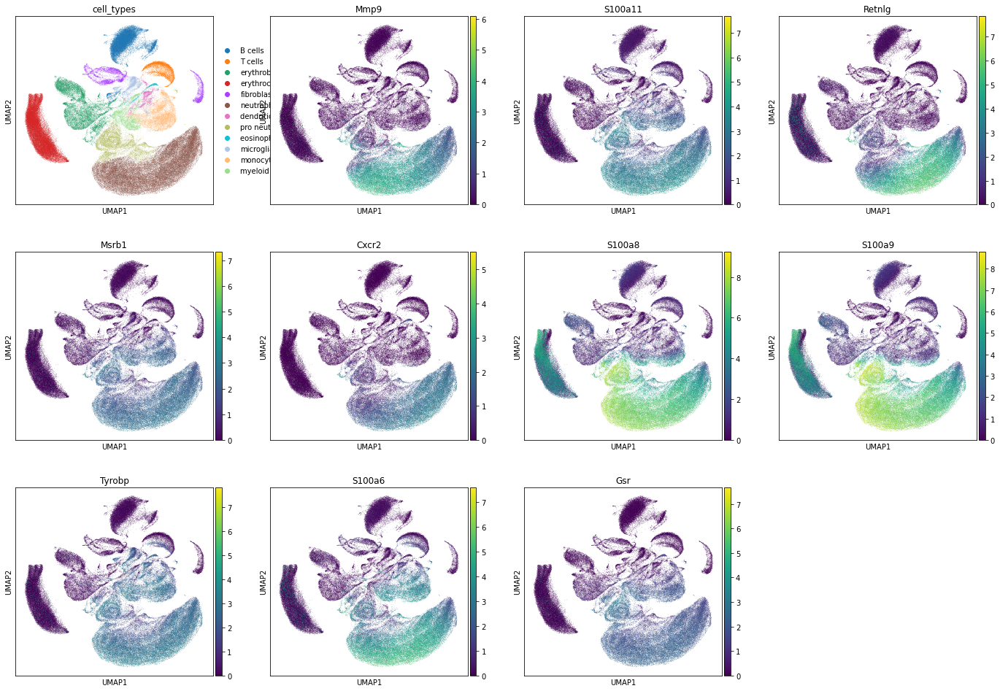

The following markers are in the first 30 DE genes
	neutrophils_G4         (2 genes): ['Retnlg', 'Mmp8']
	intermediate monocytes (1 genes): ['S100a8']
	pre-pro-B cell         (1 genes): ['Tyrobp']


In [84]:
sc.settings.verbosity = 0
a = adata_original.copy()
sc.tl.rank_genes_groups(a,groupby='cell_types',groups=[CT_OI])
rcParams['figure.figsize']= (4,4)
sc.pl.umap(a,color=f'cell_types')
rcParams['figure.figsize']= (4,3)
sc.pl.rank_genes_groups(a)#,ncols=6)
sc.pl.rank_genes_groups_dotplot(a)
rcParams['figure.figsize']= (5,5)
sc.pl.umap(a,color=['cell_types']+[g[0] for g in a.uns['rank_genes_groups']['names'][:10]])
rcParams['figure.figsize']= (10,10)
print("The following markers are in the first 30 DE genes")
markers_in_list([g[0] for g in a.uns['rank_genes_groups']['names'][:30]])
sc.settings.verbosity = 3
del a

### Test celltype (`CT_OI`) vs full neighbouring celltypes
<sup>[[back to overview]](#Template-script-to-investigate-celltype-clusters)</sup>   

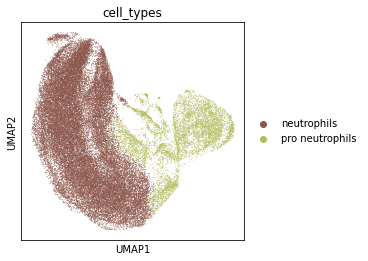

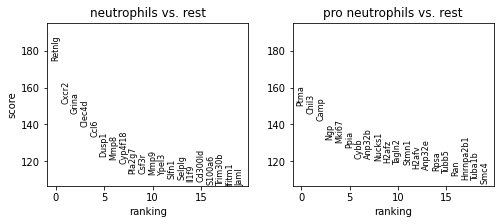

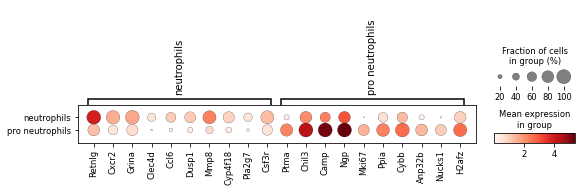

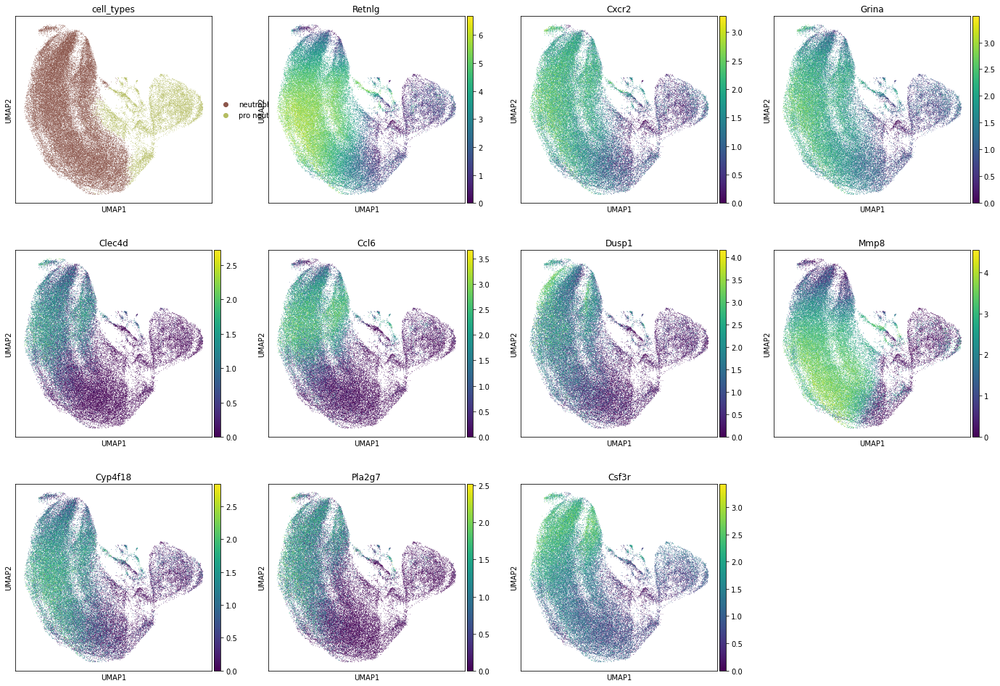

The following markers are in the first 30 DE genes of neutrophils
	neutrophils_G4                 (3 genes): ['Retnlg', 'Mmp8', 'Ccl6']
	eosinophil/basophil progenitor (1 genes): ['Ifitm1']
	fibroblasts                    (1 genes): ['Fxyd5']


In [85]:
sc.settings.verbosity = 0
a = adata_n.copy()
sc.tl.rank_genes_groups(a,groupby='cell_types')#,groups=[CT_OI])
rcParams['figure.figsize']= (4,4)
sc.pl.umap(a,color=f'cell_types')
rcParams['figure.figsize']= (4,3)
sc.pl.rank_genes_groups(a,ncols=6)
sc.pl.rank_genes_groups_dotplot(a)
rcParams['figure.figsize']= (5,5)
tmp_idx = a.uns['rank_genes_groups']['names'].dtype.names.index(CT_OI)
sc.pl.umap(a,color=['cell_types']+[g[tmp_idx] for g in a.uns['rank_genes_groups']['names'][:10]])
rcParams['figure.figsize']= (10,10)
print(f"The following markers are in the first 30 DE genes of {CT_OI}")
markers_in_list([g[tmp_idx] for g in a.uns['rank_genes_groups']['names'][:30]])
sc.settings.verbosity = 3
#del a

## DE genes Leiden level
<sup>[[back to overview]](#Template-script-to-investigate-celltype-clusters)</sup>   

### Test Leiden clusters vs celltype (`CT_OI`) background
<sup>[[back to overview]](#Template-script-to-investigate-celltype-clusters)</sup>   

########## Leiden resolution = 0.25 ##########


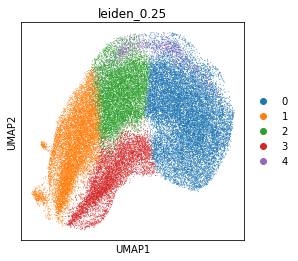

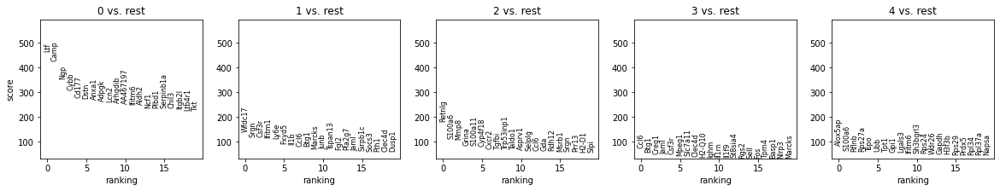

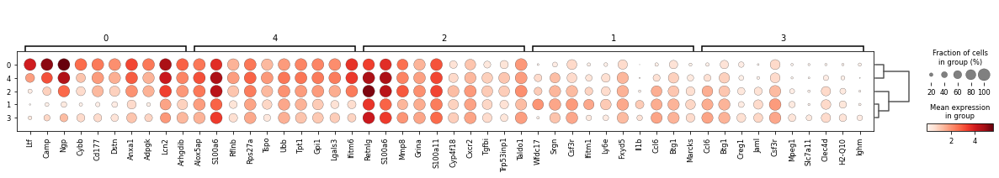

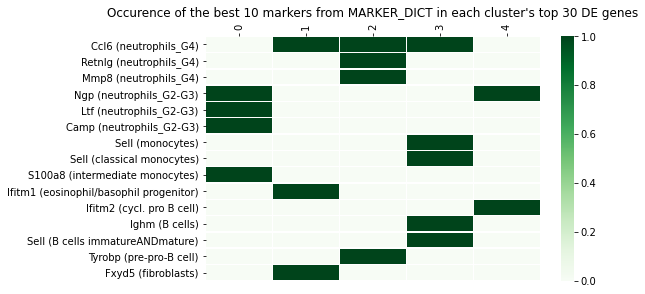

########## Leiden resolution = 1 ##########


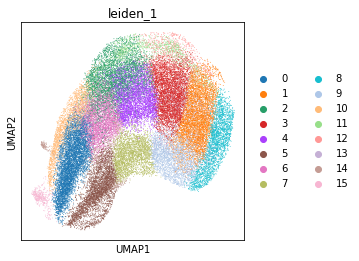

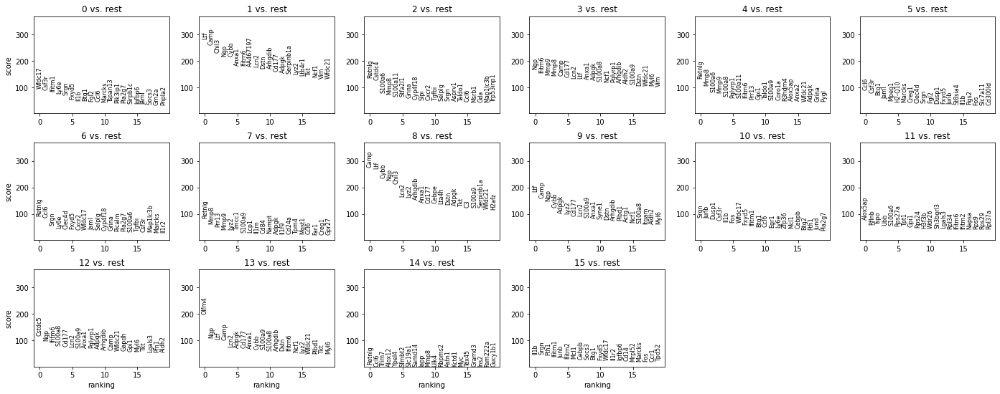

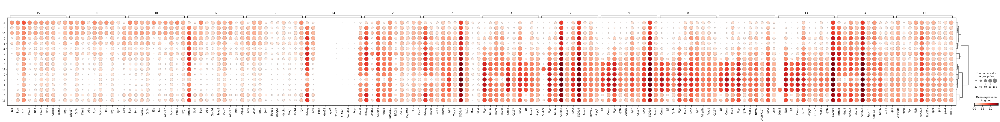

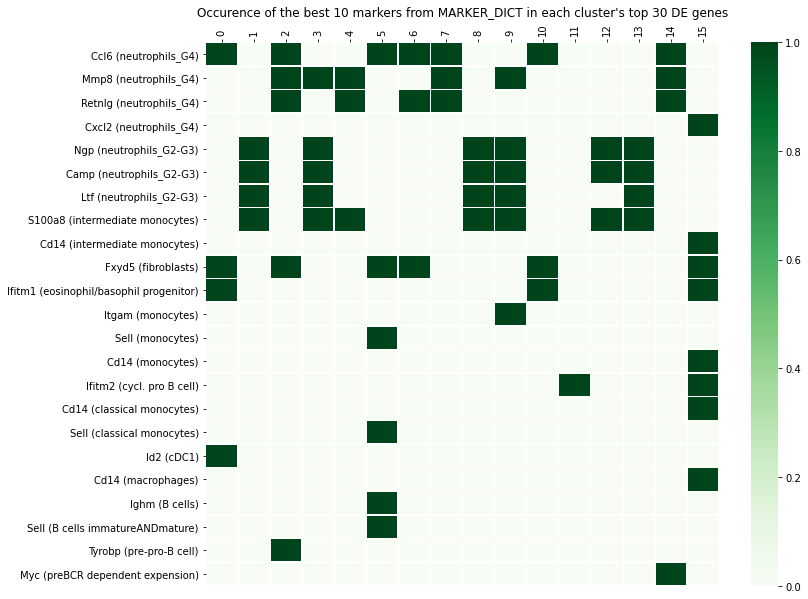

########## Leiden resolution = 3.5 ##########


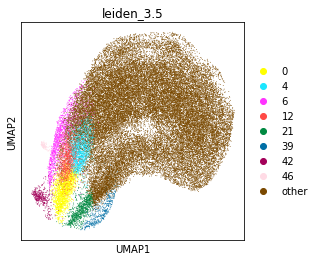

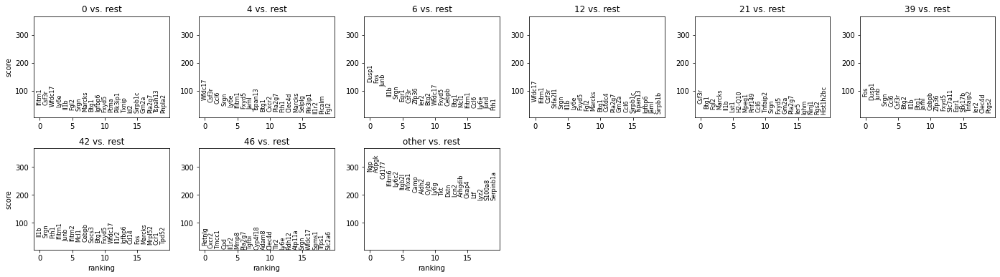

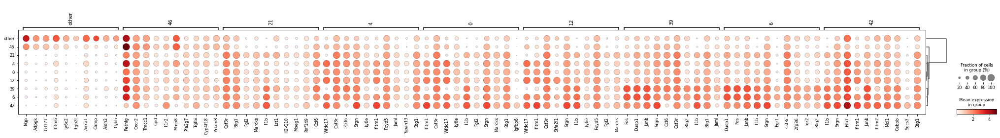

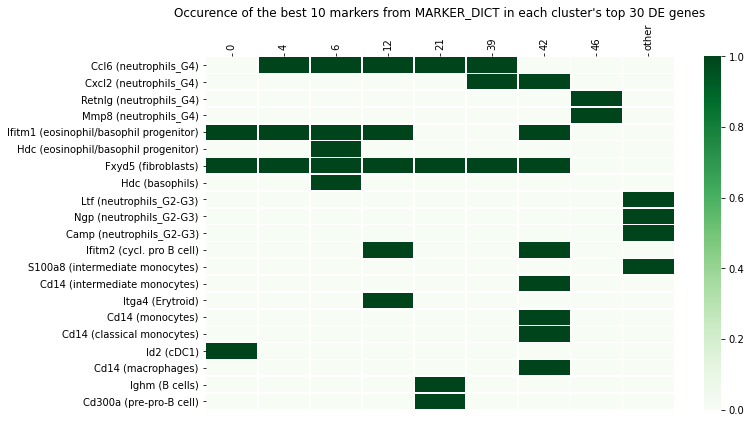

In [86]:
sc.settings.verbosity = 0
for res in resolutions:
    print(f"########## Leiden resolution = {res} ##########")
    a = adata.copy()
    sc.tl.rank_genes_groups(a,groupby=f'leiden_{res}')
    rcParams['figure.figsize']= (4,4)
    sc.pl.umap(a,color=f'leiden_{res}')
    rcParams['figure.figsize']= (4,3)
    sc.pl.rank_genes_groups(a,ncols=6)
    sc.pl.rank_genes_groups_dotplot(a)
    plot_marker_occurence(a,top_DE=30,top_marker=10)
rcParams['figure.figsize']= (10,10)
sc.settings.verbosity = 3

### Dissociation protocol affected genes
Check out Supplementary Text and Figures of "Single-cell sequencing reveals dissociation-induced gene expression in tissue subpopulations" https://www.nature.com/articles/nmeth.4437#MOESM1. There tables of DE genes that are affected by the protocol.

In [96]:
DE_tmp_genes = ['Fos','Dusp1','Junb','Srgn','Btg2','Il1b','Jaml','Egr1','Zfp36','Ier2','Btg1','Fth1','Mcl1','Cebpb','Socs3']
diss_prot_affected_genes = [
    'Fos','Hspa1a','Jun','Fosb','Junb','Egr1','Hspa1b','Ubc','Zfp36','Hspb1',
    'Hsp90aa1','Mt2','Dnajb1','Btg2','Nr4a1','Cebpd','Hspa8','Mt1','Ier2','Dnaja1',
    'Socs3','Atf3','Jund','Cebpb','Id3','Ppp1r15a','Hspe1','Cxcl1','Dusp1',
    'Hsp90ab1','Nfkbia','Hsph1'
]
# there were some more DE lists I checked the genes that didn't pop up in the first list, but then in the second:
diss_prot_affected_genes += ['Btg1','Mcl1']

for g in DE_tmp_genes:
    if g not in diss_prot_affected_genes: 
        print(f'Gene not in dissociation protocol affected genes list: {g}')

Gene not in dissociation protocol affected genes list: Srgn
Gene not in dissociation protocol affected genes list: Il1b
Gene not in dissociation protocol affected genes list: Jaml
Gene not in dissociation protocol affected genes list: Fth1


From those genes I think Il1b looks the most specific to Skull/Meninges specific neutrophils. But we have so many genes from the list. The cluster might really be due to technical effects. Or this technical effects that we see in other data might just be of the same nature as the skull specific effects that we find here.


# Trajectory analysis
<sup>[[back to overview]](#Template-script-to-investigate-celltype-clusters)</sup>   

## Pseudotime
<sup>[[back to overview]](#Template-script-to-investigate-celltype-clusters)</sup>   

In [87]:
def get_root_point_candidates(adata,sparse=False):
    if sparse:
        points = np.array(list(itertools.product([-1,0,1], repeat=2)))
    else:
        points = np.array(list(itertools.product([-1,-0.5,0,0.5,1], repeat=2)))
    
    mi = adata.obsm['X_umap'].min(axis=0)
    ma = adata.obsm['X_umap'].max(axis=0)
    mean = (ma + mi)/2
    scale = (ma - mi)/2
    ratio = scale[1]/scale[0]
    
    X = []
    for point in points:
        X.append(point * scale + mean)
    X = np.array(X)
    
    X_eq = np.array([ratio,1])*X
    U_eq = np.array([ratio,1])*adata.obsm['X_umap'].copy()
    
    cells = []
    for x in X_eq:
        dist = np.linalg.norm(x[np.newaxis]-U_eq,axis=1)
        cells.append(dist.argmin())    
    return cells

def plot_candidates(adata,cells):
    a = adata.copy()
    a.obs['root_points'] = 'others'
    for i, cell in enumerate(cells):
        a.obs.iloc[cell, a.obs.columns.get_loc('root_points')] = i
        #a.obs.iloc[cell,'root_points'] = i
        
    s = [10 if not i in cells else 400 for i in range(a.n_obs)]
    plt.rcParams.update({'font.size': 22})
    rcParams['figure.figsize']= (7,7)
    sc.pl.umap(a,color='root_points',s=s,legend_loc='on data',frameon=False)
    rcParams.update(matplotlib.rcParamsDefault)
    rcParams['figure.figsize']= (10,10)


<span style="color:green">Choose a `ROOT_POINT` from the candidates plotted below</span>. If root points are overlapping and you can't read the number of your favorite one <span style="color:green">make the following adjustment: `get_root_point_candidates(adata,sparse=True)` instead of `sparse=False`</span>

... storing 'root_points' as categorical


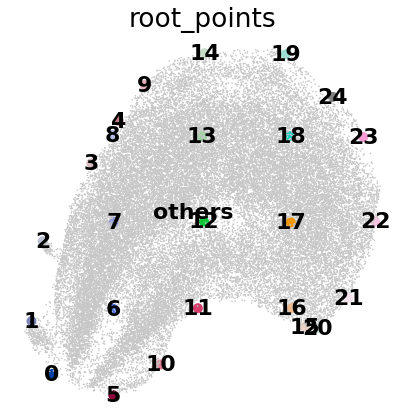

In [88]:
cells = get_root_point_candidates(adata,sparse=False)
plot_candidates(adata,cells)

In [97]:
ROOT_POINT = 22

In [98]:
adata.uns['iroot'] = cells[ROOT_POINT]
sc.tl.dpt(adata)
adata_n.uns['iroot'] = adata_n.obs.index.get_loc(adata.obs.iloc[cells[ROOT_POINT]].name)
sc.tl.dpt(adata_n)

computing Diffusion Maps using n_comps=15(=n_dcs)
computing transitions
    finished (0:00:00)
    eigenvalues of transition matrix
    [1.         0.9967131  0.98675096 0.9758418  0.9728545  0.9675392
     0.9653748  0.96068    0.9569161  0.9502387  0.9470477  0.94415474
     0.9430249  0.9383697  0.9352478 ]
    finished: added
    'X_diffmap', diffmap coordinates (adata.obsm)
    'diffmap_evals', eigenvalues of transition matrix (adata.uns) (0:00:04)
computing Diffusion Pseudotime using n_dcs=10
    finished: added
    'dpt_pseudotime', the pseudotime (adata.obs) (0:00:00)
computing Diffusion Maps using n_comps=15(=n_dcs)
computing transitions
    finished (0:00:00)
    eigenvalues of transition matrix
    [1.         0.9981306  0.9956624  0.9915514  0.987439   0.9860177
     0.98491585 0.9836269  0.9784236  0.97540706 0.97461236 0.9729062
     0.971378   0.96885735 0.9685917 ]
    finished: added
    'X_diffmap', diffmap coordinates (adata.obsm)
    'diffmap_evals', eigenvalues of 

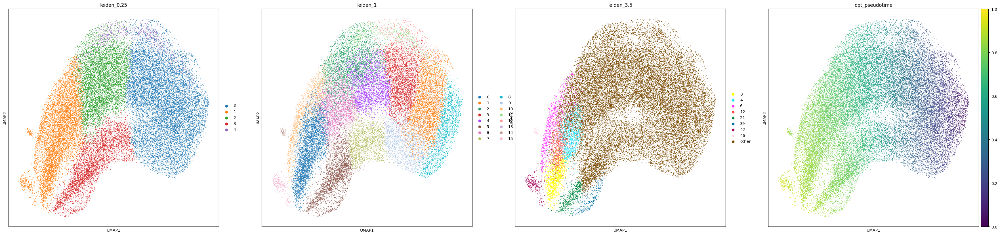

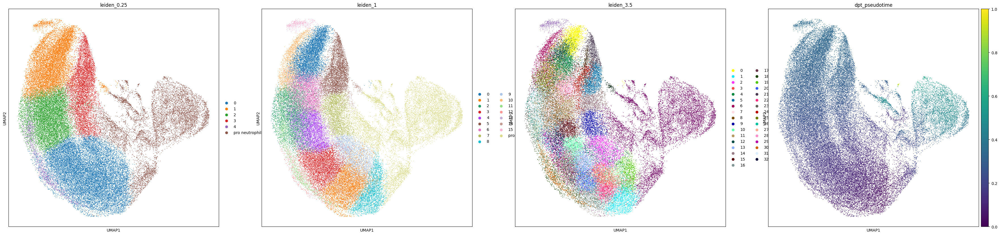

In [99]:
sc.pl.umap(adata,color=[f"leiden_{res}" for res in resolutions]+['dpt_pseudotime'],s=S)
sc.pl.umap(adata_n,color=[f"leiden_{res}" for res in resolutions]+['dpt_pseudotime'],s=S_NEIGHBORS)

## Velocity/Cellrank
<sup>[[back to overview]](#Template-script-to-investigate-celltype-clusters)</sup>   

In [100]:
a = adata.copy()

del a.uns['neighbors']
del a.obsm['X_pca']
del a.varm['PCs']
del a.obsp

a.X = a.layers['spliced']
scv.pp.filter_and_normalize(a, min_shared_counts=20, n_top_genes=2000)
scv.pp.moments(a, n_pcs=30, n_neighbors=30)

scv.tl.recover_dynamics(a,n_jobs=24)    
scv.tl.velocity(a, mode='dynamical')
scv.tl.velocity_graph(a)

Filtered out 8769 genes that are detected 20 counts (shared).
Normalized count data: X, spliced, unspliced.
Extracted 2000 highly variable genes.
Logarithmized X.
computing PCA
    on highly variable genes
    with n_comps=30
    finished (0:00:09)
computing neighbors
    finished (0:01:10) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:11) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
recovering dynamics (using 24/32 cores)


  0%|          | 0/1237 [00:00<?, ?gene/s]

    finished (0:26:43) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing velocities
    finished (0:03:30) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:03:48) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


computing velocity embedding
    finished (0:00:29) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


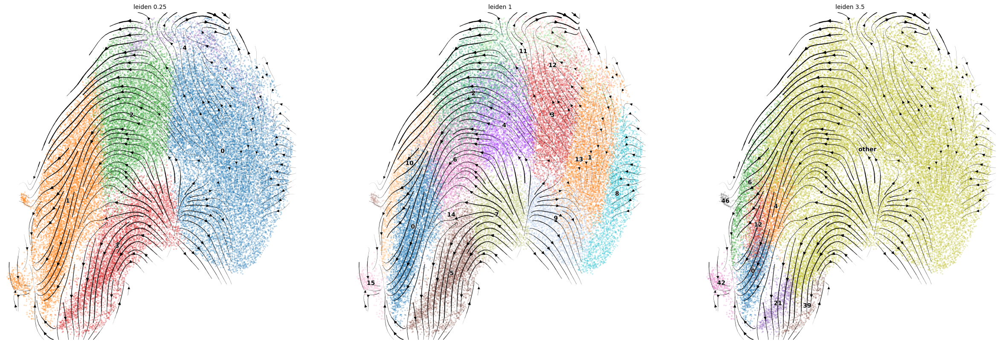

In [101]:
scv.pl.velocity_embedding_stream(a, basis='umap', color=[f'leiden_{res}' for res in resolutions],legend_loc='on data',show=True)

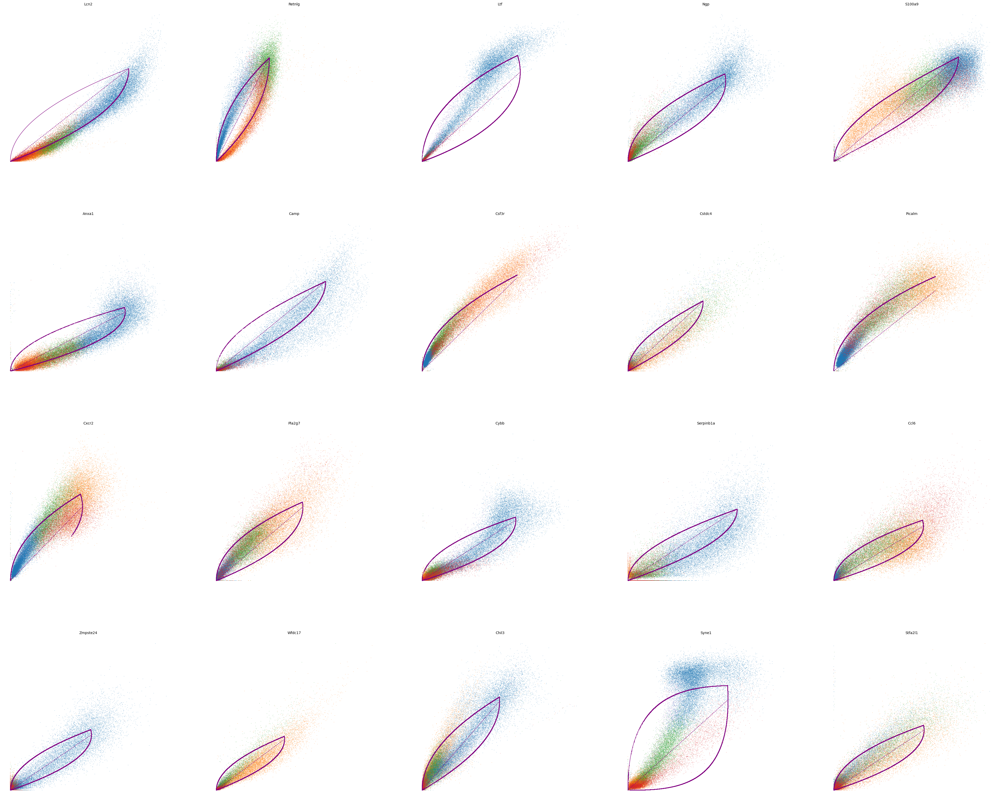

In [102]:
top_genes = a.var['fit_likelihood'].sort_values(ascending=False).index
scv.pl.scatter(a, basis=top_genes[:20], ncols=5, frameon=False, color='leiden_0.25')

# Final mappings
<sup>[[back to overview]](#Template-script-to-investigate-celltype-clusters)</sup>   

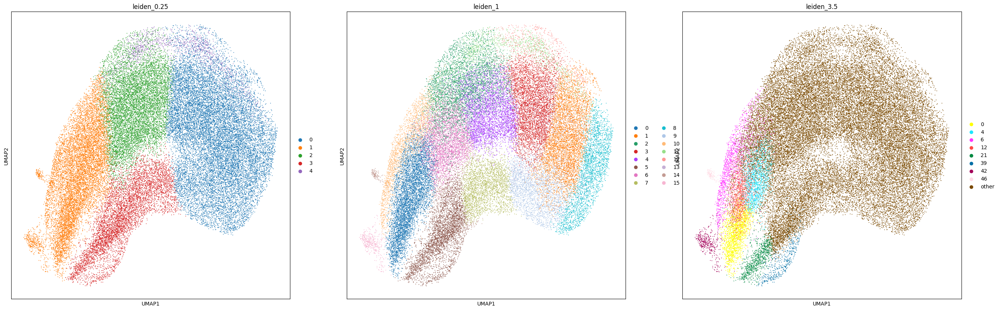

In [103]:
sc.pl.umap(adata,color=[f'leiden_{res}' for res in resolutions],s=S)

#### Save leiden resolutions as file (easier to use for later, no need to rerun the script)

In [104]:
adata.obs[[f'leiden_{res}' for res in resolutions]].to_csv(f'./{CT_OI}.csv')

# In case mappings are performed here (otherwise continue in file `final_annotations.ipynb`)

In [84]:
if os.path.exists(results_file_path):
    df = pd.read_csv(results_file_path,index_col=0)
else:
    df = pd.DataFrame(index=adata_original.obs.index, data={'level2':'unmapped','level1':'unmapped'})

- Set `FINE_ANNOTATIONS` to set the level2 celltypes states. We always first annotate the lower resolution cluster and then (eventually partially) overwrite them with the mappings for higher resolution clusters.   
- Optionally also reannotate coarse celltype annotations (obs_key `'cell_types'`) via `COARSE_REANNOTATIONS`. Same procedure as above.
- Ideally all cells are mapped wrt level2!
stick to the following structure for the next cell
```
FINE_ANNOTATIONS = {
    'res_0.25': {
        '0': 'cell_state1',
        '1': 'cell_state2',
        #.... till last leiden cluster (if res=0.25 is your "go-to resoltuion")
    },
    'res_0.5': {
        '1': 'cell_state3',
    },
}
COARSE_REANNOTATIONS = {
    'res_0.5': {
        '4': 'erythrocytes',
    },  
}
```

In [82]:
FINE_ANNOTATIONS = {
    # mappings for clusters of (different) leiden resolution 
    '1': {
        '0': 'mature B cell',
        '1': 'mature B cell',
        '2': 'mature B cell',
        '3': 'mature B cell',
        '4': 'pre B cell',
        '5': 'immature B cell',
        '6': 'mature B cell',
        '7': 'pro B cell',
        '8': 'mature B cell',
        '9': 'mature B cell',
        '10': 'mature B cell',
        '11': 'pro B cell',
        '12': 'mature B cell',
        '13': 'memory B cell',
        '14': 'immature B cell',
    },
}
COARSE_REANNOTATIONS = {
    #'0.5': {
    #    '4': 'erythrocytes',
    #},  
}

In [85]:
for res in resolutions:
    if str(res) in FINE_ANNOTATIONS:
        for leiden_cl, ct in FINE_ANNOTATIONS[str(res)].items():
            df.loc[adata.obs.loc[adata.obs[f'leiden_{res}'] == leiden_cl].index,'level2'] = ct
    if str(res) in COARSE_REANNOTATIONS:
        for leiden_cl, ct in COARSE_REANNOTATIONS[str(res)].items():
            df.loc[adata.obs.loc[adata.obs[f'leiden_{res}'] == leiden_cl].index,'level1'] = ct            

In [86]:
df.loc[df['level2']!='unmapped']

,level2,level1
index,,
AAACCCACATTCACAG-1-0,mature B cell,unmapped
AAACCCATCAACTGAC-1-0,mature B cell,unmapped
AAACCCATCCCGTGAG-1-0,mature B cell,unmapped
AAACGAAAGTAGGCCA-1-0,mature B cell,unmapped
AAACGCTCATCGGAGA-1-0,mature B cell,unmapped
...,...,...
TTTGATCCAGAAGCTG-1-30,mature B cell,unmapped
TTTGGAGCAGGTTACT-1-30,immature B cell,unmapped
TTTGGTTGTACAAACA-1-30,mature B cell,unmapped


In [87]:
df.to_csv(results_file_path)

In [88]:
adata_tmp = adata.copy()

In [89]:
adata_tmp.obs[['level1','level2']] = df[['level1','level2']]

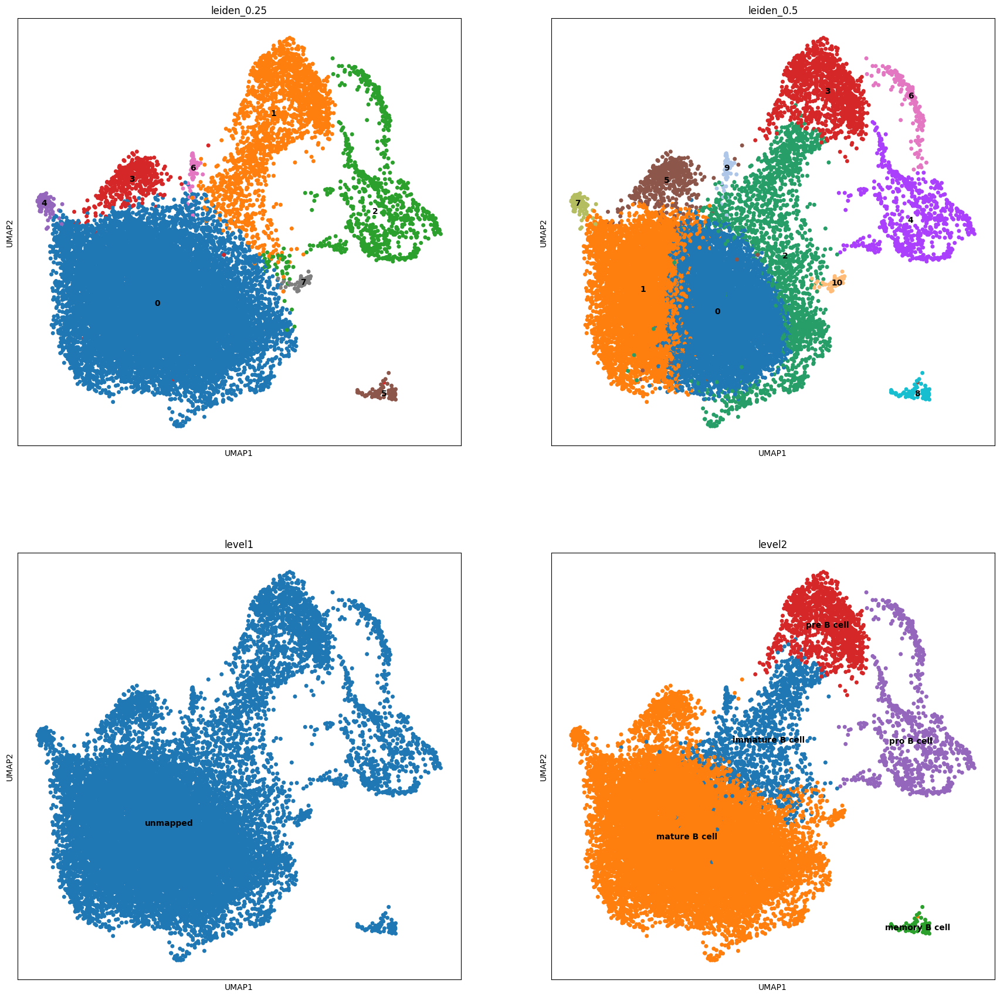

In [92]:
sc.pl.umap(adata_tmp,color=['leiden_0.25','leiden_0.5','level1','level2'],s=S,ncols=2,legend_loc='on data')

## Cluster mappings
<sup>[[back to overview]](#Template-script-to-investigate-celltype-clusters)</sup>   

# Final clusters
<sup>[[back to overview]](#Template-script-to-investigate-celltype-clusters)</sup>   